In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.linear_model import ElasticNet

In [ ]:
path = "https://raw.githubusercontent.com/DSEI21000-S21/project-tennis-ml/main/wta_matches/wta_matches-2000-2021.csv"
def readData(path):
    df = pd.read_csv(path)
    return df
wta_data = readData(path)
wta_data.head(1)

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,winner_name,winner_hand,winner_ht,winner_ioc,winner_age,loser_id,loser_seed,loser_entry,loser_name,loser_hand,loser_ht,loser_ioc,loser_age,score,best_of,round,minutes,w_ace,w_df,w_svpt,w_1stIn,w_1stWon,w_2ndWon,w_SvGms,w_bpSaved,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points
0,2000-D001,Fed Cup G1 PO: JPN vs CHN,Hard,4,D,20000430,1,201419,NaN,NaN,Na Li,R,172,CHN,18.173853525,201085,NaN,NaN,Shinobu Asagoe,R,NaN,JPN,23.8384668036,7-6(6) 6-2,3,RR,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,190,121,125,205


In [ ]:
def dropGibberishRows(dataframe, column_name, filter_variable):
    index_list = list(dataframe[dataframe[column_name] == filter_variable].index)
    dataframe = dataframe.drop(index_list)
    return dataframe
wta_data = dropGibberishRows(wta_data, 'tourney_id', 'tourney_id')
# test if the gibberish data is still in place
#wta_data[wta_data['tourney_id'] == 'tourney_id']

In [ ]:
def encodeColumn(dataframe, column_list = []):
    df = pd.get_dummies(dataframe, columns= column_list)
    return df
wta_data = encodeColumn(wta_data, column_list =['surface', 'tourney_name', 'tourney_level', 'winner_hand', 'winner_ioc', 'loser_hand','loser_ioc','round'])
wta_data.head(1)

,tourney_id,draw_size,tourney_date,match_num,winner_id,winner_seed,winner_entry,winner_name,winner_ht,winner_age,loser_id,loser_seed,loser_entry,loser_name,loser_ht,loser_age,score,best_of,minutes,w_ace,w_df,w_svpt,w_1stIn,w_1stWon,w_2ndWon,w_SvGms,w_bpSaved,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,...,loser_ioc_PUR,loser_ioc_ROU,loser_ioc_RSA,loser_ioc_RUS,loser_ioc_SAM,loser_ioc_SCG,loser_ioc_SGP,loser_ioc_SIN,loser_ioc_SLO,loser_ioc_SRB,loser_ioc_SRI,loser_ioc_SUI,loser_ioc_SVK,loser_ioc_SWE,loser_ioc_SYR,loser_ioc_THA,loser_ioc_TJK,loser_ioc_TKM,loser_ioc_TPE,loser_ioc_TRI,loser_ioc_TTO,loser_ioc_TUN,loser_ioc_TUR,loser_ioc_UKR,loser_ioc_URU,loser_ioc_USA,loser_ioc_UZB,loser_ioc_VEN,loser_ioc_VIE,loser_ioc_YUG,loser_ioc_ZIM,round_BR,round_F,round_QF,round_R128,round_R16,round_R32,round_R64,round_RR,round_SF
0,2000-D001,4,20000430,1,201419,NaN,NaN,Na Li,172,18.173853525,201085,NaN,NaN,Shinobu Asagoe,NaN,23.8384668036,7-6(6) 6-2,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,190,121,125,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0


In [ ]:
def convertDate(dataframe, date):
    dataframe[date] = pd.to_datetime(dataframe[date], format = '%Y%m%d', errors='coerce')
    return dataframe
wata_data = convertDate(wta_data, 'tourney_date')
wta_data.head(1)   

,tourney_id,draw_size,tourney_date,match_num,winner_id,winner_seed,winner_entry,winner_name,winner_ht,winner_age,loser_id,loser_seed,loser_entry,loser_name,loser_ht,loser_age,score,best_of,minutes,w_ace,w_df,w_svpt,w_1stIn,w_1stWon,w_2ndWon,w_SvGms,w_bpSaved,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,...,loser_ioc_PUR,loser_ioc_ROU,loser_ioc_RSA,loser_ioc_RUS,loser_ioc_SAM,loser_ioc_SCG,loser_ioc_SGP,loser_ioc_SIN,loser_ioc_SLO,loser_ioc_SRB,loser_ioc_SRI,loser_ioc_SUI,loser_ioc_SVK,loser_ioc_SWE,loser_ioc_SYR,loser_ioc_THA,loser_ioc_TJK,loser_ioc_TKM,loser_ioc_TPE,loser_ioc_TRI,loser_ioc_TTO,loser_ioc_TUN,loser_ioc_TUR,loser_ioc_UKR,loser_ioc_URU,loser_ioc_USA,loser_ioc_UZB,loser_ioc_VEN,loser_ioc_VIE,loser_ioc_YUG,loser_ioc_ZIM,round_BR,round_F,round_QF,round_R128,round_R16,round_R32,round_R64,round_RR,round_SF
0,2000-D001,4,2000-04-30,1,201419,NaN,NaN,Na Li,172,18.173853525,201085,NaN,NaN,Shinobu Asagoe,NaN,23.8384668036,7-6(6) 6-2,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,190,121,125,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0


In [ ]:
def addDateFeatures(dataframe, date):
    dataframe['year'] = dataframe[date].dt.year
    dataframe['month'] = dataframe[date].dt.month
    dataframe['day'] = dataframe[date].dt.day
    return dataframe
wta_data = addDateFeatures(wta_data, 'tourney_date')    

In [ ]:
def appendTarget(dataframe, winner, loser):
    dataframe[winner] = 1
    dataframe[loser] = 0
    return dataframe
wta_data = appendTarget(wta_data, 'winner', 'loser')
wta_data.head(1)

,tourney_id,draw_size,tourney_date,match_num,winner_id,winner_seed,winner_entry,winner_name,winner_ht,winner_age,loser_id,loser_seed,loser_entry,loser_name,loser_ht,loser_age,score,best_of,minutes,w_ace,w_df,w_svpt,w_1stIn,w_1stWon,w_2ndWon,w_SvGms,w_bpSaved,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,...,loser_ioc_SCG,loser_ioc_SGP,loser_ioc_SIN,loser_ioc_SLO,loser_ioc_SRB,loser_ioc_SRI,loser_ioc_SUI,loser_ioc_SVK,loser_ioc_SWE,loser_ioc_SYR,loser_ioc_THA,loser_ioc_TJK,loser_ioc_TKM,loser_ioc_TPE,loser_ioc_TRI,loser_ioc_TTO,loser_ioc_TUN,loser_ioc_TUR,loser_ioc_UKR,loser_ioc_URU,loser_ioc_USA,loser_ioc_UZB,loser_ioc_VEN,loser_ioc_VIE,loser_ioc_YUG,loser_ioc_ZIM,round_BR,round_F,round_QF,round_R128,round_R16,round_R32,round_R64,round_RR,round_SF,year,month,day,winner,loser
0,2000-D001,4,2000-04-30,1,201419,NaN,NaN,Na Li,172,18.173853525,201085,NaN,NaN,Shinobu Asagoe,NaN,23.8384668036,7-6(6) 6-2,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,190,121,125,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,2000,4,30,1,0


In [ ]:
def getMissingDataPercentage(dataframe):
    percent_missing = dataframe.isnull().sum() * 100 / len(dataframe)
    missing_value_df = pd.DataFrame({'column_name': dataframe.columns,
                                 'percent_missing': percent_missing})
    pd.set_option("max_rows", None)
    return missing_value_df

In [ ]:
def formatColumns(dataframe):
    columns = list(dataframe.columns)
    renamed_columns = [i.lower().strip().replace(' ', "_").replace(':','') for i in columns]
    renamed_columns_dict = {columns[i]: renamed_columns[i] for i in range(len(columns))}
    dataframe = dataframe.rename(columns = renamed_columns_dict)
    return dataframe
wta_data = formatColumns(wta_data)   

In [ ]:
def convertColumnsToNumeric(dataframe, columns = []):
    dataframe[columns] = dataframe[columns].apply(pd.to_numeric, errors ='coerce')
    return dataframe 


In [ ]:
columns_list = ['best_of','score','loser_age','loser_ht','winner_ht','winner_age','loser_seed','loser_entry','winner_entry','winner_seed','draw_size', 'match_num', 'winner_id', 'loser_id','minutes','w_ace','w_df', 'w_svpt', 'w_1stin','w_1stwon',            
'w_2ndwon', 'w_svgms', 'w_bpsaved','w_bpfaced','l_ace','l_df','l_svpt','l_1stin','l_1stwon','l_2ndwon','l_svgms',             
'l_bpsaved','l_bpfaced','winner_rank','winner_rank_points','loser_rank','loser_rank_points']
wta_data = convertColumnsToNumeric(wta_data, columns=columns_list)

In [ ]:
wta_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 59719 entries, 0 to 59739
Columns: 3054 entries, tourney_id to loser
dtypes: datetime64[ns](1), float64(32), int64(10), object(3), uint8(3008)
memory usage: 195.2+ MB


In [ ]:
getMissingDataPercentage(wta_data).head(20)

,column_name,percent_missing
tourney_id,tourney_id,0.000000
draw_size,draw_size,0.000000
tourney_date,tourney_date,0.000000
match_num,match_num,0.000000
winner_id,winner_id,0.000000
winner_seed,winner_seed,58.055225
winner_entry,winner_entry,100.000000
winner_name,winner_name,0.000000
winner_ht,winner_ht,40.201611
winner_age,winner_age,0.018420


In [ ]:
data = getMissingDataPercentage(wta_data)
mask = data['percent_missing'] !=0
cols = list(data[mask]['column_name'])

def fillMissingData(dataframe, cols):
    dataframe[cols]= dataframe[cols].fillna(dataframe.mode().iloc[0])
    return dataframe
wta_data = fillMissingData(wta_data, cols)

In [ ]:
df = wta_data.drop(['tourney_id','winner_entry','loser_entry', 'score', 'tourney_date', 'winner_name','loser_name'], axis =1)
df.info(verbose =True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 59719 entries, 0 to 59739
Data columns (total 3047 columns):
 #    Column                                    Dtype  
---   ------                                    -----  
 0    draw_size                                 int64  
 1    match_num                                 int64  
 2    winner_id                                 int64  
 3    winner_seed                               float64
 4    winner_ht                                 float64
 5    winner_age                                float64
 6    loser_id                                  int64  
 7    loser_seed                                float64
 8    loser_ht                                  float64
 9    loser_age                                 float64
 10   best_of                                   int64  
 11   minutes                                   float64
 12   w_ace                                     float64
 13   w_df                                      f

In [ ]:
columns = ['winner_age', 'loser_age']
df = convertColumnsToNumeric(df, columns=columns)

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:3069: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


In [ ]:
#sns.pairplot(df.iloc[:,0:20])
df.iloc[:,1:20]

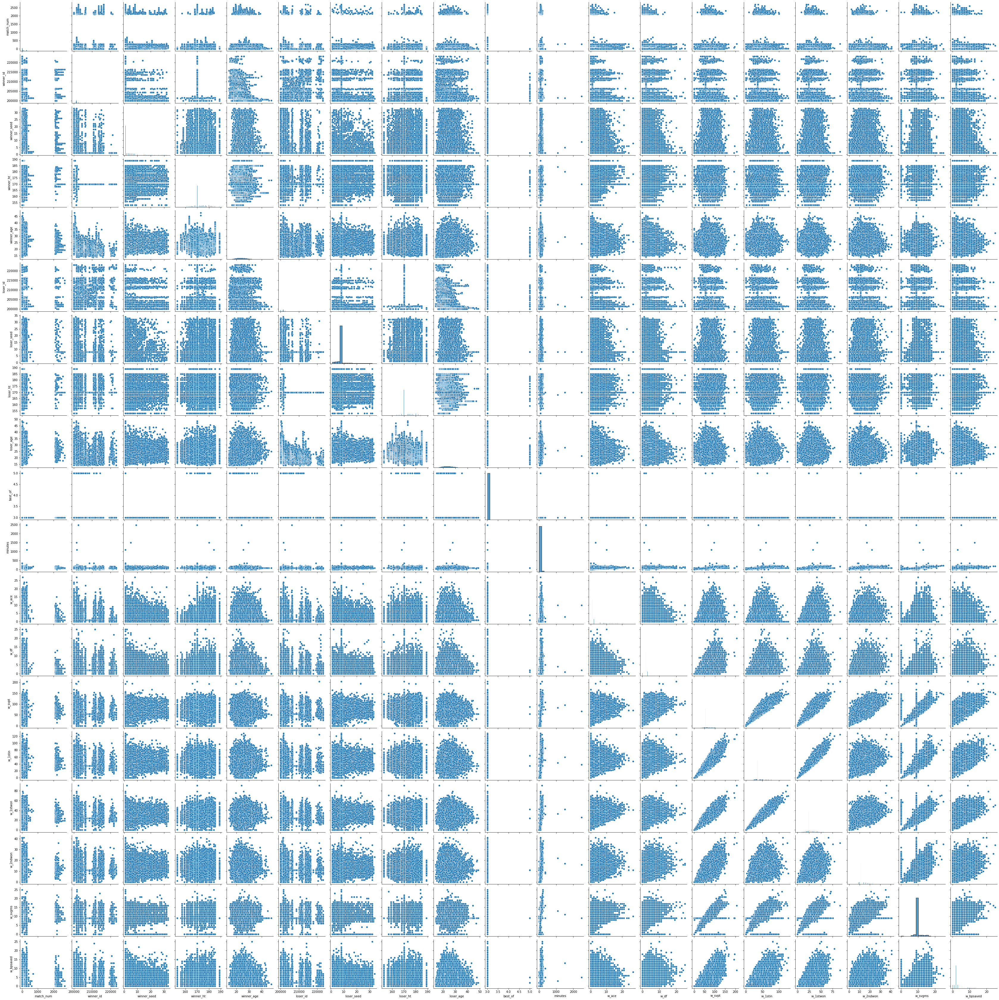

In [ ]:
sns.pairplot(df.iloc[:,1:20])

In [ ]:
pca = PCA(10)
principalComponents = pca.fit_transform(df)

In [ ]:
principalComponents_df = pd.DataFrame(principalComponents)
principalComponents_df

,0,1,2,3,4,5,6,7,8,9
0,-1435.857389,310.580385,-1661.119292,-322.313555,-47.113128,20.000228,77.742866,-39.658249,0.338712,1.608118
1,-3107.975103,-155.958153,-668.627961,-558.286952,-25.743961,-47.296755,-32.065538,-53.021406,3.582623,1.736582
2,-2923.265949,269.736206,1383.437930,-901.247331,-60.940553,-53.402335,8.265872,-60.924782,5.163031,1.717641
3,-3289.329121,-227.413751,3264.330708,-744.581110,-90.674792,-22.194133,45.618087,-67.665061,5.410019,1.984915
4,-2407.482794,-852.155635,302.640031,-527.721449,-44.830754,-70.867723,-14.293632,-56.463630,3.793280,1.781849
5,-3182.349538,-255.531789,929.789617,-701.294962,-48.686431,-58.961982,0.780097,-60.108536,4.835931,1.873599
6,-2940.727655,329.797847,2065.061270,1119.820963,-104.473169,-3.353347,-6.244398,-63.557383,-3.311009,3.570752
7,-3356.568138,-158.925498,3496.488982,-52.651084,-105.589875,0.682175,38.322854,-68.452106,2.527868,2.669304
8,-3347.997048,-151.185184,3708.585886,575.569886,-118.816768,24.576647,29.660038,-69.100377,-0.152859,3.226051
9,-3225.404588,-68.232901,318.869020,1019.128338,-61.800881,-45.726128,-19.812922,-58.804521,-2.710585,3.195318
